In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [10]:
df = pd.read_csv('restaurant-menus.csv')
df

,restaurant_id,category,name,description,price
0,1,Extra Large Pizza,Extra Large Meat Lovers,Whole pie.,15.99 USD
1,1,Extra Large Pizza,Extra Large Supreme,Whole pie.,15.99 USD
2,1,Extra Large Pizza,Extra Large Pepperoni,Whole pie.,14.99 USD
3,1,Extra Large Pizza,Extra Large BBQ Chicken &amp; Bacon,Whole Pie,15.99 USD
4,1,Extra Large Pizza,Extra Large 5 Cheese,Whole pie.,14.99 USD
...,...,...,...,...,...
4450094,55227,Beverage,Sprite,NaN,2.49 USD
4450095,55227,Beverage,Gold Peak Iced Tea,NaN,2.49 USD
4450096,55227,Sweets,Churros,NaN,5.49 USD
4450097,55227,Sweets,New York-Style Cheesecake,NaN,5.49 USD


In [11]:
df.isnull()

,restaurant_id,category,name,description,price
0,False,False,False,False,False
1,False,False,False,False,False
2,False,False,False,False,False
3,False,False,False,False,False
4,False,False,False,False,False
...,...,...,...,...,...
4450094,False,False,False,True,False
4450095,False,False,False,True,False
4450096,False,False,False,True,False
4450097,False,False,False,True,False


In [14]:
# filtering data with description cloumn
description= pd.isnull(df["description"])
description

0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

In [24]:
# convert the price column to numeric format
df['price'] = df['price'].str.replace(' USD', '').astype(float)
df.head()

,restaurant_id,category,name,description,price
0,1,Extra Large Pizza,Extra Large Meat Lovers,Whole pie.,15.99
1,1,Extra Large Pizza,Extra Large Supreme,Whole pie.,15.99
2,1,Extra Large Pizza,Extra Large Pepperoni,Whole pie.,14.99
3,1,Extra Large Pizza,Extra Large BBQ Chicken &amp; Bacon,Whole Pie,15.99
4,1,Extra Large Pizza,Extra Large 5 Cheese,Whole pie.,14.99


In [25]:
# calculate summary 
df.describe()

,restaurant_id,price
count,4.450099e+06,4.450099e+06
mean,2.663991e+04,1.042749e+01
std,1.556922e+04,1.385920e+01
min,1.000000e+00,-7.050000e+00
25%,1.391500e+04,3.990000e+00
50%,2.611800e+04,7.990000e+00
75%,3.964500e+04,1.311000e+01
max,5.522700e+04,1.395000e+03


In [27]:
# finding outliers in the price range
#calculate interquartile range
Q1 = df['price'].quantile(0.25)
Q3 = df['price'].quantile(0.75)
IQR =Q3 -Q1

# define the lower bound and the upper bound
lower_bound =Q1 -1.5 * IQR
upper_bound =Q3 + 1.5 * IQR

# find outliers
outliers = df[(df['price'] < lower_bound) | (df['price'] > upper_bound)]
outliers


,restaurant_id,category,name,description,price
286,6,Picked for you,Hereford Filet Mignon,"Potato pave, haricot verts, caramalized onion ...",44.00
287,6,Picked for you,Alaskan Halibut,"lemongrass &amp; ginger tea crusted, cucumber ...",40.00
288,6,Picked for you,King Crab Cobb Salad,"plus king crab, avocado, quail eggs, bacon lar...",43.00
289,6,Picked for you,Grilled King Salmon,"artichoke barigoule, baby carrots, pearl onion...",36.00
292,6,Appetizers &amp; Salads,King Crab Cobb Salad,"plus king crab, avocado, quail eggs, bacon lar...",43.00
...,...,...,...,...,...
4450011,55223,FAMILY MEALS,Family Signature Tray,"A collection of our ""biggest hits"" from our De...",48.21
4450012,55223,FAMILY MEALS,Family Pasta Feast,Your choice of one Hot Pasta. Served with four...,41.37
4450013,55223,FAMILY MEALS,Family Jane Bar,Giant baked potatoes wrapped hot and ready to ...,41.37
4450014,55223,FAMILY MEALS,Family Southwest Wrap Tray,"A combination tray featuring a Ranchero Wrap, ...",45.25


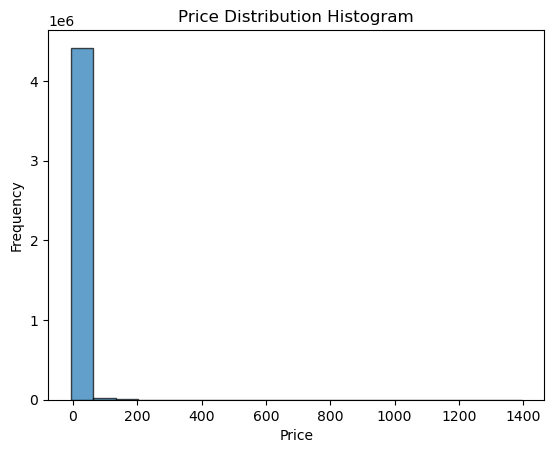

In [31]:
# histogram to show the distribution of prices
plt.hist(df['price'], bins=20, edgecolor='k', alpha=0.7)

# Set labels and title
plt.xlabel('Price')
plt.ylabel('Frequency')
plt.title('Price Distribution Histogram')

# Show the histogram
plt.show()

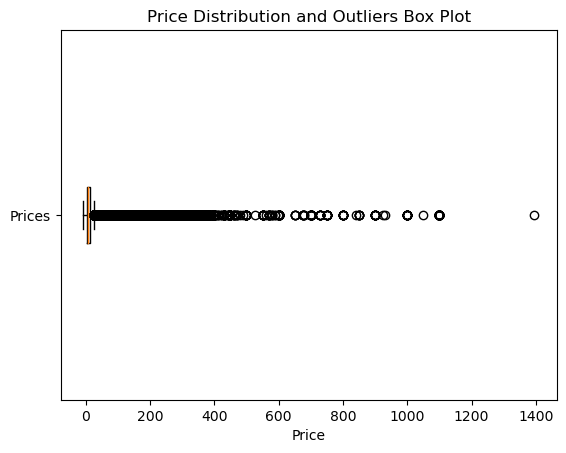

In [33]:
# price using box plot
# Create a box plot of 'Price'
plt.boxplot(df['price'], vert=False, labels=['Prices'], showfliers=True)

# Set labels and title
plt.xlabel('Price')
plt.title('Price Distribution and Outliers Box Plot')

# Show the box plot
plt.show()


In [35]:
# find the actual minimum and maximum price 
maximum_price =df['price'].max()
minimum_price =df['price'].min()
print(f'maximum price: {maximum_price} minimum price: {minimum_price}')

maximum price: 1395.0 minimum price: -7.05


In [39]:
# count of each category to understand the distribution of each category
category_count=df['category'].value_counts()
category_count.head(10)


Picked for you    202106
Beverages         135944
Sides             128256
Sandwiches        125203
Drinks            115393
Appetizers         89013
Salads             69277
Desserts           45882
Breakfast          42740
Snacks             38194
Name: category, dtype: int64

In [51]:
# lets calcualte the average price of each categor
average_price =df.groupby('category')['price'].mean()
# sort the data 
average_price =average_price.sort_values(ascending=False)
average_price.head(15)
    

category
Strollers                                            414.413868
Sponsor Boxed Meals                                  370.000000
Entrees                                              288.888889
Gift box Champagne                                   282.117500
Prime Rib Meals                                      270.565000
Christmas and New Year Specials (Non -Vegetarian)    269.990000
Christmas and New Year Specials (Vegetarian)         269.990000
Catering Packages                                    265.720000
Dinner for 10                                        258.880000
King Crab Uptown lb                                  251.970000
Party Pack (Serve 25)                                249.990000
CATERING COMBOS + PACKAGES                           249.725694
Office Packs                                         243.323333
Christmas Tray                                       239.000000
King Crab lb                                         233.970000
Name: price, dtype: float64

In [55]:
# identify the top selling items by countinng the frequency of each item name
top_selling = df['name'].value_counts()
print(top_selling)


Bottled Water                                7511
French Fries                                 7069
Iced Tea                                     4671
Onion Rings                                  4503
Sprite                                       4366
                                             ... 
Curry Goat &amp; Jerk Wings Combo               1
Curry Goat &amp; Brown Stew Chicken Combo       1
Curry Goat &amp; Curry Chicken Combo            1
Oxtail &amp; Ziggy Wings Combo                  1
Spicy Chorizo Tacos                             1
Name: name, Length: 878650, dtype: int64


In [61]:
# Determine the highest-priced and lowest-priced items in the menu.
 #Find the highest-priced item
highest_priced_item = df[df['price'] == df['price'].max()]
# Print the highest-priced and lowest-priced items
print("Highest-Priced Item:")
highest_priced_item

Highest-Priced Item:


,restaurant_id,category,name,description,price
4374354,54106,Curries,Spicy Massaman Curry,"Cardamom, cinnamon star anise, and bay leaf.",1395.0


In [68]:
# Find the lowest-priced item
lowest_priced_item = df[df['price'] == df['price'].min()]
print("\nLowest-Priced Item:")
lowest_priced_item


Lowest-Priced Item:


,restaurant_id,category,name,description,price
660059,7658,Fajitas,Chicken en Mole,Boneless chicken breast in a sweet and spicy M...,-7.05
660061,7658,Fajitas,Pollo a la Ranchera,Grilled chicken breast in a spicy molcajete sa...,-7.05


In [70]:
# item variation analysis 
# Group the data by 'Category' and list unique variations within each group
category_variations = df.groupby('category')['description'].unique()
# Print the variations within each category
for category, variations in category_variations.items():
    print(f"Category: {category}")
    print(f"Variations: {description}\n")



Category: 
Beverages
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 
Ramen
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 
Starters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category:     APPETIZER 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: "Hot" Chicken &amp; Catfish
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: "House Special
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: "Immune Boosting" Fresh Pressed Juices
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: (SS) Sauces/Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: (ST) Snacks/Tiffins
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: (Salads) 3rd
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: *Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: *Sandwiches*
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: *Seafood
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 10" Gluten Free/Low Carb Cauliflower Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 10" Gluten Friendly Hand Tossed Pies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 10" Gluten Friendly Pies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 18" Very Large
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 18" Whole Pies*
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 18" X-Large Whole Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 7.5" Grilled Subs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 7.5" Sub Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: 7.Vegetable Rolls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: A Sweet Treat Dessert Menu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: A Taste from South of The Borden
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: A Taste of Africa
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Aahaar Lunch Boxes (Thali in a box)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Aahaar Meat / Seafood Entrée
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Aahaar Rice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Agua Fresca
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Agua Fresca and more
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Agua Frescas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: All Day Menu - Chicken
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: All Day Menu - Chow Mei Fun
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: All Day Menu - Chow Mein
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: And Ribs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: And Then Some

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: And Thine Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizer (Non-Veg)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizer (Non-Vegetarian)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizer (Pupu’s)

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizers (Mezethes)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizers (Mon Khai Vi)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizers (Mon khai vi)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizing Appetizers!
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizing Oven Baked Protein Subs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Appetizing Stuff
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Asian Fusion
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Asian Fusion - Appetizer
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Asian Fusion - Beef
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Auténtica Comida de Campeche
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Avalanches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Aves
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: BBQ Sammiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: BBQ Sammies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: BBQ Sandwich
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: BRUNCH ALL DAY
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: BRUNCH COCKTAILS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: BRUNCH ENTREES - 11:00AM to 2:00pm / served on saturdays &amp; sundays only
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Baked Roll
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Baked Roll A La Carte
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Baked Rolls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Barbeques
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Barbercue From Around The World
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Barbercue From The Vegetable Garden
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bebidas / Beverages - Soft Drinks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bebidas / Drinks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bebidas /Beverages
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beef Special (Halal)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beef Special Combination Combo Platters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beef Special XYZ
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beer/Sake
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beer/Wine/Cider
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beer/Wine/Sake
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Between The Buns
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Between The Buns (Lunch and Dinner)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Between The Buns!
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beverages/Aguas Frescas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beverages/Bebidas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Beverages/Chips
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Big Star Salads (Lunch)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Big State Extras
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Big State Platters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bison Desserts*
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bisque &amp; Gumbo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bisteck Platters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boba Tea 16oz
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boba Tea Drinks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boba Tea Time
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boss Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boss Wings
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boss's Choice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098 


Category: Boudain Kolaches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boudin
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boudin 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Boudin &amp; Kountry Boys Kolaches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bread Parotta
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bread Selection
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bread Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Brothers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Brunch (Available Saturday and Sunday AM ONLY til 3PM)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Buffets
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Mariposa Plate
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Meal Prep
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Meals
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Staples
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Start-Ups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfast Starters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfasts / Tacos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfasts Mains
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Breakfasts Side Orders
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Brunch A La Carte
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Brunch A la Carte
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Brunch Add ons
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Buddy's Specialty Pizzas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Buddy-G
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Budget Buster
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Build Your Own Hot Dog
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Build Your Own Indian Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Build Your Own Indomie
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bulk Items (Petra Spices)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bulk Me Up
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Bulk Meat
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burger y tacos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burger's
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burger's and Sandwich's
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burgers in a Bag
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burgers n Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burgers on a Bun
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burritos and Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burritos and Quesadillas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Burritos and Rellenos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CAKE SLICES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CAKES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CAKES 2lb
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CHIK'N SANDWICHES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CHILD'S PLATES 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CHILDREN'S MENU
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CRAVIN CHIC'N Combos DP
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CRAVIN CHIC'N Daily Specials DP
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: CRAVIN TENDERS &amp; Biscuit DP
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cake by the Slice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cake donuts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cake in a Cup
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Candy
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Candy 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Candy   Gummies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Casserole 煲
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Casserole 砂鍋類
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Casserole 砂锅类
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chaats (Savory Snacks)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chaats (Snacks)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chachote Specials
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cheese Macchiato
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cheese Macchiato 芝士玛奇朵
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cheese Milk Foam
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chef's Special Friday, Saturday Dinner Only*
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chef's Special From Kitchen 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chef's Special Hot Pots to Share
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicago Pie "Original Chicago"
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicago Pie Original Chicago
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicago Pit Style BBQ Items
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicken Dishes over Fried Rice (各式鸡盖炒饭)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicken Doner Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicken Drumsticks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicken Tenders Strips
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicken Tenders Strips Combo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chicken Tenders and Nuggets
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Children (Breakfast)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Children (Dinners)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Children (Los Niños)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chinese Combos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chinese Corner
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chinese Crepe
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chirashi and Donburi
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chiyoshi's Recommendation
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chiyoshi's Signature
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chow Mein or Chop Suey
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chow Mein or Egg Foo Young
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Chow Mein with Crispy Noodles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Classic Eggs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Classic Enchiladas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Classic Entree Catering
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Clay Pot Stew
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Clay Pot 煲仔
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Clay Pot 黄焖系列
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Coffee Beans and To Go Boxes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Coffee Beverages
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Coffee Blenders
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cold Drinks - On Tap
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cold Drinks - Single Serve Bottles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Cold Drinks Hot Drinks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Combinaciónes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Combinado
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Combinados (Combinations)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Combo familiares
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Combo for Salad or Bowl
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Combo for Two (Happy)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Congee and Rice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Congee 粥
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Congee 粥 (Chao)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Country Cookin' Dinners
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Country Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Country Favorites (Lunch and Dinner)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Create Your Own Pizza (Baking Required)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Create Your Own Pizza Online
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Create Your Own Pizza and Wing
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Crooked Hoagies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Crooked Salads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Crooked Specialty Pizzas- Unlimited Toppings, No Additional Charge
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Curry up - Mutton(Goat)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Curry up - Sea Food
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Curry up - Vegetarian
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: DQ® Treats
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: DR PEPPER PRODUCTS 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: DRESSINGS &amp; SAUCES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Danny's Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Daq
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dark Chocolate Bars with Inclusions
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Deli - News Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Deli Bagel Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Deli Bar
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Desert Breakfast
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Desert Quesadilla
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Deserts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Desserts D
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Desserts DP
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Desserts Daily
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner - Chicken / Pollo 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner - Cold
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner - Delicious Del Mar / Seafood
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner Firsts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner Floats
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner For 2
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner Pork Entrees
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner Postres
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dinner Poultry
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dips 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dips &amp; Appetizers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dips &amp; Chips
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Don (Rice Dishes)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Don Bowl
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Don Bu Ri
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dozen Cupcakes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dozen Cupcakes 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Dozen Donut
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Drinks - Energy
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Drinks - Fiery Intentions Smoothies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Drinks - Healthy Intentions
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Du Jour Catch Special
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Duck
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Duck &amp; Chicken
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Echesela carnal
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Echigo Special (Bento)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Eclair
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Eggs and Benedicts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Eggs and Cakes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Eggs and Companions
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Enchiladas and Tacos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Enchiladas and Tamales
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Enchiladas and Tamales 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Entree / Teriyaki
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Entree Add ons
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Entree Chicken
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Entrée (Platos De Entrada)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Entrée (Pork)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Entrée (Poultry)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Espresso Bar
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Espresso Bar - 12 oz
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Espresso Bar - Hot
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Extra Large Pizzas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Extra Large Pizzas xyz
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Extra Large Premier Pizzas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: FAMILY MEALS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: FAMILY MEALS        
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: FAMILY MEALS (For 4-6 Serving)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fajitas 2Go
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fajitas A Las Brasas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fajitas A la Escondida
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Family Pack Biryani
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Family Pack Biryani (4 to 6 Peoples)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Family Pack Biryanis
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Famous Grill Potatoes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Famous Gyoza Combos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Famous Gyro
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Favorites To Share
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Favorites de Mecho
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Favorites to Share
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: First Course Selections 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: First Course-Appetizers (Primi Piatti)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: First Downs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fish, Seafood &amp; Cajun Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fish, Shrimp and Chicken Dinners
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fish, Shrimp, and Veggie Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Flirt For Dessert
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Float
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Float Selection
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Foundation Pizzas 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Foundation Pizzas - 11"
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Foundation Salads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Cut Fries and Chips and Salsa
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Cut Fruit
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Cut Garden Salads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Lemonades
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Limeade
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Louisiana Crawfish
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Teas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Tender
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fresh Tenders
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Chicken
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Chicken 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Chicken  
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Menu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Mezza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Momo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Rice Lo Mein
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Rice Lunch
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Rice Mania
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Up!
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Vegetable/Fried Lo-Mein/Stir Fried
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fried Veggies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: From The BBQ Pit
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: From The Bar
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: From The Case
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Frontier's Sweet Side
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Frostalattes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Frosted Cookies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fruit Tea 水果茶系列
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fruit Tea 鮮果茶系列
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fruit Tea 鲜果茶
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fusion Salad Bowls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fusion Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Fusion Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Garden Selections
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Garden Stop
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Garden Toasts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Getting Chippie
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Getting Serious Bigger Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Getting Started
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gluten Free Fried Rice 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gluten Free Frozen Breads, Bagels &amp; Pizza Crusts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gluten Free Gourmet Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Goat Currys
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Goat Dishes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Goat Entree
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gotta Have Me Some
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gotta Have Munchies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gotta Have Sundaes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grab N Go Snacks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grab N' Go
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grab N' Go's
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Greek Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Greek Sides and Desserts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Greek Snacks and Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grilled Cheese and More
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grilled Cheese's
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grilled Cheeseburgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grilled Selections with Vermicelli or Steam Rice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grilled Shawarma Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Grilled Shrimp
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gus's Menu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gus's Variety Cookies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Gusgerias
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: HH Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: HIBACHI DINNER - DRINKS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: HIBACHI DINNER - FRIED RICE
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Ham
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Ham Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Ham Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hand made 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hand pull thin noodles/手擀面
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hand roll
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Have Some Slice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Have Them Fried
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Have an Appetizer-Delicious Starters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hearty Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hearty Soups and Stews (Serves One)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hearty Starters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hippo Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hippo Chicken and Extras
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hirata Buns
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Homemade Pizzas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Homemade Ramen
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Homemade Rattlesnake
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hot Cakes Molten Chocolate Cake
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hot Cakes and French Toast
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hot Cakes and Waffles (Breakfast)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hot Plate Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hot Plate with Miso Soup
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Hot Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: House Fried Rice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: House Greens
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: House Handmade Noodle 自製手搟麵
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: House Specialties Combos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: House Specialties Fajitas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: House Specialties Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Huevos (Dinner)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Huevos (Egg Dishes)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Huevos (Eggs)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Ice Cream Cup
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Ice Cream Cup (Nieve en Vaso)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Ice Cream Cupcakes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Illy Espresso Drinks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Imagination Has No Limits
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Immune Booster Shots
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Individual Bagels
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Individual Biscuits
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Individual Box Lunches - (Allow a little extra prep time)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Iron Chef
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Iron Pan
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Iron Pan Entree
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Jams &amp; spreads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Jams, Jellies, &amp; Sweet Spreads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Jane Pound Cakes - Serve 12  
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Jet's Boats and Deli Boats
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Jhakkas Sizzzlers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Jhol Momo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Juices (West Seattle)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Juices + Cleanses
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Juices - Fresh
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Just For Kids 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Just For Kids'
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Just For Kids' -  (Lunch / Dinner)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kababs and Grill
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kabob
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kabob - Served with Basmati rice, mixed salad and side Chickpea curry. No substitution on any items. All items come MILD. Extra charge for spicy sauce under Category "Side"
Variations: 0          False
1

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kebabs and Salad
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kebabs and sizzlers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kebabs with Salad
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kid's Korner
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kid's Los Paisitas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kid's Lunch
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids  Menu*
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Nam

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids Fun
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids Grilled Sliced French Bread Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids Hibachi
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids Menu (Menú Infantil)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids Menu (Menú de Niños)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids Menu (Nanos)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids'
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids' (Lunch)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kids' Breakfast
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: King's Crawfish and Shrimp
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: King's Gourmet Sausages
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: King's Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Korean BBQ
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Korean BBQ 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Korean BBQ  Platter
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Kray Cray Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Krazy Bag
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Krazy Fries
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: LUNCH GRILL
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: LUNCH ITEMS - AVAILABLE EVERY DAY
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: LUNCH MAINS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Large (15") Crowd Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Large (16 oz.)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Large (Brown Sugar Boba)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Las Parrilladas - From the Grill
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Las Peligrosas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Las Planchitas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lemonade and Milk Shakes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lemonade's &amp; Soda's
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lemonade, Iced Tea, and Gatorade
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lil Homies Menu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lil Jerks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lil Luchadore Meal Combo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Little Hearth Kids
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Little Hero
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Little Hoos Kids Mains
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Long Haul
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Long Johns
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Long Life Noodles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lukas Specials
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lukas Spuds
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lula at home 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Expansions
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Express
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Expresso 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Menu / Steamed Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Menu / Steamer Bags
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Menu / Stew
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Special from Sushi Bar
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Special with Premium Side
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch Special with Two Homestyle Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch and dinner
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch and dinner plate
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Lunch at Broyo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: MANGONADAS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: MANGONADAS (24 fl oz)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: MANGONADAS NATURALES 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: MYO Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: MYOC
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Ma'amoul
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Nam

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Main Course Or Dinner
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Main Course Selections
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Main Course Traditional Indian Curries
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Make Your Own Burger
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Make Your Own Burrito
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Make Your Own Catch
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mama's Subs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mama's Tacos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mama's Vegetarian Specialty
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Martinis
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Marty's House Specialties
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Marvelous Melt Shop
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meals (Platos)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meals (late)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meals (pm)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meat and Seafood Entrees
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meat and Seafood Entrée
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meat and Seafood Sausages
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Medicines & Treatments/Children's Health Care
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Medicines & Treatments/Cough, Cold & Flu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Medicines & Treatments/Digestive Health & Nausea
Variations: 0          False
1          False
2          False
3          False
4         

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meetha - Desserts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Meethi Muskaan
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mega Beverages
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Menufy Drinks Delivery
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Menufy Huarache Delivery
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Menú
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mexican Dishes (Antojitos Mexicanos)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mexican Dishes (Platillos Mexicanos)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mexican Dishes / Platos Mexicanos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mexicanos Antojitos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mexicans Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mexico
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Milk &amp; Tea
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Milk + T
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Milk Bar
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Miller Lite
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Miller Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Miller's Killer's
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mix Series
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mix Vegetables with Steamed Rice
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mix and Match
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mofongos 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mofongos (Green plantains fried and mashed)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mofongos Rellenos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mousehouse Jack
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mousse
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Mousse Cakes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: N'awlins Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: N-More
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: N-More Combo with Fries and Drink
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Naan [breads]
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Naan and Bread
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Naan and Breads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Nepali Specialties (Veg)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Nepali Specialtiles (Non-Veg)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Nepali Tea
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Nigiri &amp; Sashimi Combo (Chef’s choice)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Nigiri &amp; Sashimi Specials
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Nigiri &amp; Sashimi Style
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Non-Alcoholic Beer 21+only
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Non-Alcoholic Beer/Wine/Spirits
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Non-Alcoholic Beverage
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Noodle Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Noodle Soups (Pho)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Noodle Soups (Thai Street Menu).
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Noodles and Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Noodles and Such
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Noodles and Tofu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: OLO-CHILDRENS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: OLO-CHIMICHANGAS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: OLO-DESSERT
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Olive Branch Signature Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Olive Chicken Garlic Flavored Trio
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Olive Chicken Strips
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: One-Third Pound Burger
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Onen Plato De Niños
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Onigiri
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Original Thai Dishes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Original Thai Food
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Original Vegan Vegetarian Food
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Our Coldpressed Smoothies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Our Combinations
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Our Creations
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Out of The Sea
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Out of This World Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Out of This World Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: PAELLA &amp; MAINS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: PAELLA MONDAY
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: PAIRINGS 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: PO' BOY
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: PO' BOYS On toasted Gambino™ Bread
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: PO' BOYS [special of the month]
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pan Fried Noodle (Crispy Noodle)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pan Fried Noodle (Wok Fried Noodles)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pan Fried Noodle or Rice Noodle
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Panini e Antipasti
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Panini grillers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Panini's
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Party Platter Entrees(8-10 people)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Party Platter Sides (8-10 people)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Party Platters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pasta Samplers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pasta Sauces and Spreads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pasta Seafood Salad
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Paw-Paw BBQ Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Paw-Paw Baked Potatoes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Paw-Paw Meat Plates
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pescado
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pescado 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pescado (Fish)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Piara pizza appetizers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Piatillos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Piatta Di Pasta
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pizza &amp; Pasta
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pizza &amp; Pizza Boats
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pizza &amp; Sub Deal
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pizza, Stromboli, and Calzone
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pizza-
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pizza- Our Signature Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Platillos Del Mar
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Platillos Dinners
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Platillos Especial
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Po'boy Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Po'boys
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Po'boys &amp; Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pork (Cerdo)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pork (Cochinito)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Pork (Come with Steam Rice)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Poultry / Aves
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Poultry Aves
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Poultry Curries
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Prima's Brick Oven Neopolitan-Style Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Prima's House Chicken Specialties
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Prima's House Pastas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Puffs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Puffs, Cornbread, Rolls, and Hush Puppies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Puffy Tacos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Quesadilla Corner
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Quesadilla DF
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Quesadilla Desayuno
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: RED WINE BOTTLE
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: RED WINE BOTTLES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: RED WINES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Raw Wraps
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Raw and Chilled
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Raw and Cooked Roll
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Regular 14" Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Regular A La Carte Entrees
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Regular Baskets
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice &amp; Flat Bread
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice &amp; Flat Bread Selection
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice &amp; Flatbreads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice Or Vegan Bowls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice Outside Roll
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice Paper Wraps
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice, Noodle, and Chow mein
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice, Noodle, and Egg Foo Young
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rice, Noodle, and Egg Foo Young Lunch
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rocky's Pan-Style Pizza - Small
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rocky's Pan-Style Pizza Large
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rocky's Pan-Style Pizza Medium
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rosette
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rosie Bake Make Deserts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Rosie's Bakery Items
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SALADS COMBOS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SALADS ENTREE
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SALADS TG
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SIDE OF ORDER 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SIDE ORDER
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SIDE ORDER (S)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SOUP (Large)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SOUP (P)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SOUP / NODDLES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: STIR-FRIED with STEAMED RICE
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: STIR-FRY
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: STKK Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Salad Slayer 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Salad Special
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Salad Specialties
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Salads, Ensaladas, Tortas, and Sandwiches

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Salads, Etc
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Salads, Pasta, Calzones, &amp; Stromboli
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Samwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: San Diego's Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: San Juanita's Tacos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches (Bahn Mi)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches (Banh Mi )
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches (Banh Mi)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches and Suff
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches and Taco
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches and Tacos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches-Halal
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches-and-Wraps
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sandwiches/Banh Mi
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sashimi and Nigiri (5 pcs)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sashimi and Nigiri Sushi
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sashimi and Roll Combo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sausage Gravy and Biscuits
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sausage Gravy or Sos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sausage Kolaches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Scallops
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Scat Specialties
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Scaturo's Crations
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood &amp; Doenjang Jjigae
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood &amp; Fish
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood &amp; Grill
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood Curry
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood Curry Pots
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood D
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood specials
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood specialties
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seafood – Đồ Biển
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seize The Pasta 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Seize the Sashimi
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sekuwa
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Shack Salad
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Shack Shelter Packs
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Shack Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Shari's Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sharing
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sharing (Jeon Goal) Hot Pots (Serves for Two)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Shrimp - Lunch
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Shrimp A La Carte
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Shrimp Basket
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sicilian Pizzas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sicilian Pizzas (Siciliana le Pizze)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sicilian Square Deep Dish Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side Items and Extras
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side Items‎
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side Kickers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side Saddles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side Salad
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side Salad or Soup
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side/Extra
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Side_Orders
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sideboard
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides - Breakfast
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides - Chips
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides - Delivery
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides of Meat
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides of Pho
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides of Sauce
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides/Sauces
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides/Sauces/Extras
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sides/Sauces/Flavorings
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Signature Dog
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Signature Dogs 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Signature Dogs All Beef
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Signature Sichuan
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Signature Sides
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Signature Sides

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Single Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Single Cakes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Single Cheese
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sleep is Overrated Menu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Slice (Cakes &amp; Cheesecakes)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Slice BYO
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Small Plates (Copy)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Small Plates (Dinner)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Small Plates (Lunch)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Smoothies (Served with Milk)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Smoothies (Sinhtố)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Smoothies (Sol-Sips)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Snacks To Go
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Snacks To Share
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Snacks and Appetizer
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soft  drink
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soft Beverage
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soft Beverages
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sopas / Soup
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sopas / Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sopas 16 oz
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soup Noodles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soup Noodles 汤拉面
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soup Of The Day
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soupless Ramen
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Souplicious
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soups and Noodles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soups and Paninis
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Soups and Pastas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Spanish and Tex Mex
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Spare Time Spuds
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Spark Bites 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Special Noodle Soup Bowls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Special Noodle Soup- Mi
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Special Noodles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Speciality Lunch Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Speciality Meat Pizza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Speciality Noodle
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Specialty Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Specialty Burgers and EJ Katsu Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Specialty Burgers and EJ Katsu Burgers

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Specialty Pizzas and Calzones (Non-Traditional)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Specialty Pizzas and Calzones (Traditional)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Specialty Pizzas xyz
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Spring Menu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Spring Roll
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Spring Rolls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Starters and Snaks (Tapas and Botanas)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Starters and Soup
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Starters and Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Steamed Rice Dishes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Steamed Rice Dishes (Cơm Dĩa)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Steamed Rice Dishes 饭类
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Stir Fry (Side of Fried rice IS NOT available)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Stir Fry (炒める)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Stir Fry (볶음류)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Street Food (Small Plate)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Street Food (อาหารตามสั่ง)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Street Food Combo (Asian Style)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SubHackers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: SubMarine Fleet
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Subgum
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sundras Grill
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sundried Tomato Wraps
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sundubu (Spicy Soft Tofu Soup)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi (2 Pieces per order)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi (2 Pieces)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi (2 pcs) and Sashimi (5 pcs)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True


Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi Nigiri (2 pcs)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi Nigiri (Assorted Sushi Plate)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi Nigiri Set
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi combo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi or  Sashimi (Cooked)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sushi or  Sashimi (Raw)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sweet Indulgence
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sweet Innovations 6 INCH AND 8 INCH
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Sweet Kine Desserts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: T-Bones
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: T-CK And Chinese Combo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: T-Shirts
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: TK Sushi Roll
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: TKJ Seafood
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: TKK Add-Ons
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tacos (Antojitos Y Mas)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tacos (Breakfast)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tacos (Combo)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Taiwanese Cuisine 台灣特色
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Taiwanese Dessert
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Taiwanese Entrees
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tandoori Specials Charcoal Clay Oven
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tandoori Specialties
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tandoori Specialties (Clay Oven)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tea Drinks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tea Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tea Forte
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tenders Combo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tenders Combos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tenders Family Meals
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097    

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Texas Bar-B-Q (By The Pound)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Texas Bebes Queso Birria
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Texas Best - Specialty Burgers, Chicken, and More
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Thai Special Drinks
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Thai Special Entree
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Thai Speciality
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: The Bullseye
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: The Bun Of Day
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: The Bundles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: The Pour House Goods
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: The Pro's Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: The Quesadilla Zones
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Thirsty Lion - Kitchen Specialties
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Thirsty Lion - Salads (dressings on side)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Thirsty Lion - Sandwiches
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094  

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: To Go Beverages Lunch
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: To Go Buffet
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: To Go Butcher Shop
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tony's Giant Burgers
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tony's Mexican Dish
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tony's New Flavors
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tostadas, Gorditas, &amp; Sopes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tostadas, Sopes &amp; Taco Salad
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Tostadas-Chalupas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Traditional Irish Pub Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Traditional Italian
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Traditional Italian  Dishes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Traditional Tamales
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Traditional Tapas
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Traditional Taste
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
44500

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Triple Delight
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Triple Delight  Dinner Special
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Triple Play Sliders
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Types oOf Rolls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Typical Brazilian Appetizer Platters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Typical Colombian Drinks 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Under $9 Lunch Special
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Under 600 and Gluten-free
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Under the Sea
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tru

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: VEGETARIAN PLATES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: VEGETARIAN ROLLS
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: VEGETARIAN | MÓN CHAY*
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Veg &amp; Vegan
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Veg (Copy)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Veg - Starters
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegan Dishes-Entrées-Stir Fried Dishes (Dinner)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegan Dishes-Salads
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegan Dishes-Soups
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetable Dishes 什菜
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetable Dishes 蔬菜
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetable Egg Foo Young
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetarian &amp; Low Calories
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetarian &amp; Tofu
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetarian &amp; Vegan
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
445

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetarian Mezza
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetarian Momo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetarian Noodle
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097   

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetariano / Veggie
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetariano Veggie
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vegetariano de Matamoros
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vermecelli Noodles (Bun)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vermicelli
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vermicelli 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     T

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Very Fruity
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Very Special Entrees
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vet Support
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vietnamese Rice and Vermicelli Bowls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vietnamese Rolls
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Vietnamese Sag Noodle	
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: WHOLE CAKES
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: WHOLE CHICKEN
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: WHOLE Pie/Cake/Dessert
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wasfi's Specially
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wash
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Washington Style Special Roll
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097 

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wham Bam Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wham! Bam! Burritos
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wham! Bam! Favorites
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wicked Entree
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wicked Our Signature Sandwich
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wicked Wings
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wing Baskets
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wing Blazers-
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wing Boxes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
445009

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wok Chinese and Teriyaki (White meat)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wok Classic
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Wok Combo
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Xi'an taste/西安小吃
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Xiangzhe Cook Style (湘浙巧手小炒)
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Xiao Long Bao
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Yogurt Tea Series
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Yogurt and Custard
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: Yogurt and Fruit Smoothies
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     Tr

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: breakfast crepes 
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: bubble tea
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: bubbles
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: parrilla from de grill
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: pasta
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: pasta Dishes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
44

Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: ✶ Simple Dessert Crepes
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: ❤Dozen Specials❤
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096     True
4450097     True
4450098     True
Name: description, Length: 4450099, dtype: bool

Category: ❤️Medium Heart-Shaped Pizza❤️
Variations: 0          False
1          False
2          False
3          False
4          False
           ...  
4450094     True
4450095     True
4450096

In [78]:
# calcualate the average price of different variationwithin a category
# Group the data by 'Category' and 'Variation' and calculate the mean price for each group
variation_prices = df.groupby(['category', 'description'])['price'].mean()
variation_prices_sorted= variation_prices.sort_values(ascending=False)
variation_prices_sorted.head(10)

category   description                                                                                                                                                                                                                                           
Curries    Cardamom, cinnamon star anise, and bay leaf.                                                                                                                                                                                                              1395.000000
Furniture  Enhance your nursery space with the Million Dollar Baby Classic Palermo 6-Drawer Chest. The chest's elegant drawer handles and square feet add a luxurious look, while clean lines and solid molding offer a stately presence.                            1099.990000
           Furnish your nursery in lodge-inspired charm with the evolur Waverly Double Dresser. Flaunting a rustic, paneled front with metal pulls, each spacious drawer is perfectly sized to store

In [1]:
# explore pontential correlations between price of an item and its cate
# Group the data by 'Category' and calculate the mean price for each group
average_prices = df.groupby('category')['price'].mean()

# Create a bar graph
plt.figure(figsize=(10, 6))  # Optional: Adjust the figure size
plt.bar(average_prices.index, average_prices.values)

# Set labels and title
plt.xlabel('Category')
plt.ylabel('Average Price')
plt.title('Average Price by Category')

# Show the bar graph
plt.xticks(rotation=45)  # Optional: Rotate category labels for better readability
plt.tight_layout()  # Optional: Adjust layout for better appearance
plt.show()

NameError: name 'df' is not defined